In [1]:
%matplotlib inline
import nltk
from nltk.probability import FreqDist 
from urllib import request # librería que nos permite realizar peticiones web
import matplotlib.pyplot as plt # librería para realizar ploteos de figuras
from nltk.corpus import stopwords # librería que contiene las palabras auxiliares del idioma inglés

In [2]:
url = 'http://www.gutenberg.org/files/2554/2554-0.txt' # url de donde se extraerá el texto
response = request.urlopen(url) # aquí se estará instanciando nuestra petición de la url
text = response.read().decode('utf-8') # aquí se guardará el texto ya decodificado por utf-8 obtenido por nuestr petición
print(text) # muestra del texto obtenido

oks. But to his great surprise she had not once approached the subject
and had not even offered him the Testament. He had asked her for it
himself not long before his illness and she brought him the book without
a word. Till now he had not opened it.

He did not open it now, but one thought passed through his mind: “Can
her convictions not be mine now? Her feelings, her aspirations at
least....”

She too had been greatly agitated that day, and at night she was taken
ill again. But she was so happy--and so unexpectedly happy--that she was
almost frightened of her happiness. Seven years, _only_ seven years! At
the beginning of their happiness at some moments they were both ready
to look on those seven years as though they were seven days. He did not
know that the new life would not be given him for nothing, that he would
have to pay dearly for it, that it would cost him great striving, great
suffering.

But that is the beginning of a new story--the story of the gradual
renewal of a man, 

In [3]:
# tamaño del texto en letras
print(len(text))

1176967


In [4]:
palabras_auxiliares = set(stopwords.words('english')) # se crea una variable que contenga todas las palabras auxiliares
print(palabras_auxiliares) # mostramos las palabras auxiliares

{'should', 'than', 'has', 'because', 'have', "it's", 'through', "didn't", 'm', 'ourselves', 'each', 'whom', 'while', 'not', 'her', 'does', 'between', 're', "couldn't", 'she', 'my', "that'll", "weren't", 'very', 'of', 't', 'now', 'about', 'won', 'themselves', 'haven', 'when', 'some', 'ours', 'are', 'you', 'with', 'can', 'isn', 'above', 'they', 'needn', 'up', 'out', 'any', "don't", "needn't", 'for', 'if', 'in', 'once', 'it', 'just', 'to', "isn't", 'he', 'an', "hasn't", 'why', "aren't", 'nor', 'during', "mustn't", 'doing', "wasn't", 'their', 'hadn', 'until', 'o', 'as', 'same', 'ma', 'myself', "mightn't", 'on', 'were', 'mightn', "wouldn't", 'most', 'at', 'don', "hadn't", 'yourself', "you're", 'both', 'will', 'into', 'here', 'couldn', "she's", 'yourselves', "shan't", "you've", "you'd", "shouldn't", 'me', 'below', "doesn't", 'more', 'against', 'mustn', 'and', 'so', "won't", 'its', 'such', 'll', 'this', 'what', 'been', 'am', 'where', 'few', 'a', 'off', 'theirs', 'didn', "should've", 'shouldn'

In [5]:
#  \w+ acepta cualquier caracter que se encuentre en el rango de [a-zA-Z0-9_]
texto_en_tokens = nltk.regexp_tokenize(text, '\w+') # aplicamos una expresión regular que haga match con nuestro texto

texto_en_tokens_sin_palabras_auxiliares = [palabra.lower() for palabra in texto_en_tokens] # transformar palabras a minúsculas para que hagan match con las palabras auxiliares
texto_en_tokens_sin_palabras_auxiliares = [palabra for palabra in texto_en_tokens_sin_palabras_auxiliares if not palabra in palabras_auxiliares] # quitamos las palabras auxiliares mediante un bucle que las busque en el texto

print(f'Longitud del texto en tokens: {len(texto_en_tokens)}') # cantidad de palabras en el texto
print(f'Longitud del texto en tokens sin palabras auxiliares: {len(texto_en_tokens_sin_palabras_auxiliares)}') # cantidad de palabras en el texto sin palabras auxiliares

Longitud del texto en tokens: 212001
Longitud del texto en tokens sin palabras auxiliares: 94137


In [6]:
# realizamos la construcción de un vocabulario
vocabulario = sorted(set(texto_en_tokens)) # set para identificar palabras únicas en el texto; sorted se utiliza acomodar por órden alfabético nuestro arreglo
vocabulario_sin_palabras_auxiliares = sorted(set(texto_en_tokens_sin_palabras_auxiliares))

print(f'Vocabulario: {len(vocabulario)}') # cantidad de palabras únicas en el texto
print(f'Vocabulario sin palabras auxiliares: {len(vocabulario_sin_palabras_auxiliares)}') # cantidad de palabras únicas en el texto sin palabras auxiliares

Vocabulario: 10729
Vocabulario sin palabras auxiliares: 9742


In [7]:
# definimos una función para obtener la riqueza lexica 
def riqueza_lexica(texto):
    vocabulario = sorted(set(texto)) # set para identificar palabras únicas en el texto; sorted se utiliza acomodar por órden alfabético nuestro arreglo
    return 100 * len(vocabulario) / len(texto) # retorna el valor de la cantidad de palabras únicas entre la cantidad de palabras del texto

print(f'Riqueza léxica: {riqueza_lexica(texto_en_tokens)}') # llamar la función
print(f'Riqueza léxica sin palabras auxiliares: {riqueza_lexica(texto_en_tokens_sin_palabras_auxiliares)}') # llamar la función

Riqueza léxica: 5.060825184786864
Riqueza léxica sin palabras auxiliares: 10.348747038890128


In [8]:
# porcentaje de aparición de una palabra dentro de un texto
def porcentaje_palabra(palabra, texto):
    return 100 * texto.count(palabra) / len(texto) # retorna el valor de las veces que se encontró la palabra buscada entre la longitud del texto multiplicado por 100

palabra = 'reason'
print(f'Porcentaje de la palabra {palabra} en el texto: {porcentaje_palabra(palabra, texto_en_tokens)}') # llamar la función para buscar la palabra "reason" en nuestro texto

Porcentaje de la palabra reason en el texto: 0.02405649029957406


In [9]:
# añadiendo la función FreqDist a nuestros tokens, esta función nos permite saber la cantidad de veces de aparición de una palabra en el texto, y mostrar el resultado en tuplas
fdist = FreqDist(texto_en_tokens)
fdist_sin_palabras_auxiliares = FreqDist(texto_en_tokens_sin_palabras_auxiliares)

In [10]:
# Vocabulario mas comun
print(f'10 palabras mas comunes: {fdist.most_common(10)}')
print(f'10 palabras mas comunes sin palabras auxiliares: {fdist_sin_palabras_auxiliares.most_common(10)}')

10 palabras mas comunes: [('the', 7437), ('and', 6290), ('to', 5413), ('a', 4470), ('I', 4401), ('of', 3848), ('he', 3633), ('you', 3506), ('in', 3099), ('that', 3068)]
10 palabras mas comunes sin palabras auxiliares: [('raskolnikov', 785), ('one', 645), ('would', 573), ('know', 530), ('said', 519), ('could', 496), ('come', 480), ('man', 479), ('like', 453), ('though', 445)]


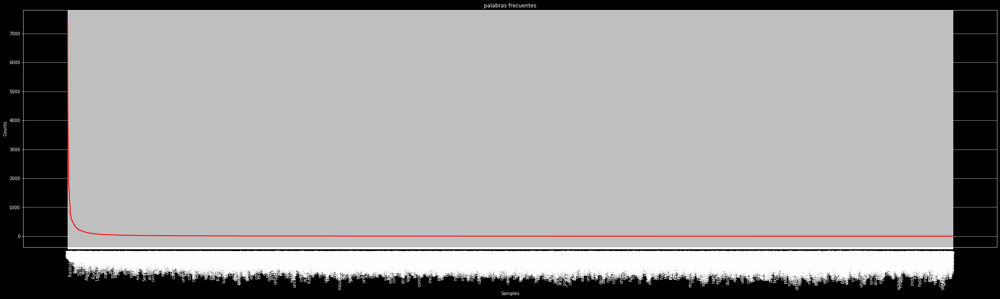

In [19]:
# graficando palabras repetidas
plt.style.use('dark_background') # usar fondo negro para nuestro plot
plt.figure(figsize=(40, 10)) # definir el tamaño de nuestra figura que se mostrará
plt.title('palabras frecuentes') # título y tamaño de la letra de nuestro plot
fdist.plot(color='red') # plot de nuestra función

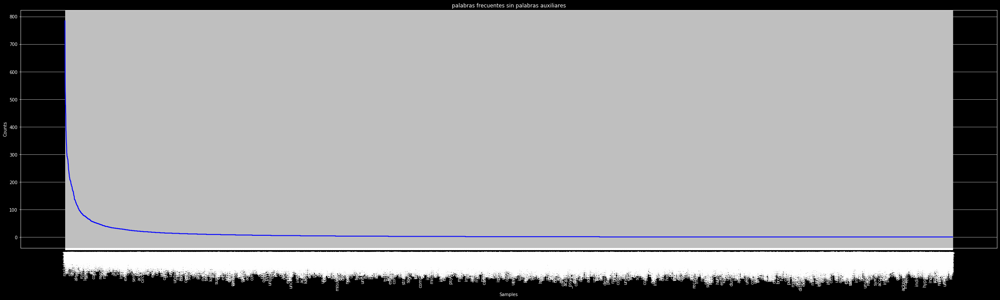

In [20]:
# graficando palabras repetidas sin palabras auxiliares
plt.style.use('dark_background') # usar fondo negro para nuestro plot
plt.figure(figsize=(40, 10)) # definir el tamaño de nuestra figura que se mostrará
plt.title('palabras frecuentes sin palabras auxiliares') # título y tamaño de la letra de nuestro plot
fdist_sin_palabras_auxiliares.plot(color='blue') # plot de nuestra función